# Mertens' Method
This notebook contains code used to combine images using Mertens' exposure fusion method. 

In [1]:
import cv2 as cv
import numpy as np
from matplotlib import pyplot as plt
%matplotlib inline 
from PIL import Image

Let us define a reusable function.

In [ ]:
mertens = cv.createMergeMertens()
def merge(fileNames, outFileName, align):
  images = [ cv.imread(fileName) for fileName in fileNames ]
  if (align):
    aligner = cv.createAlignMTB()
    aligner.process(images, images)
  hdr = mertens.process(images)
  hdr_8bit = np.clip(hdr * 255, 0, 255).astype('uint8')
  cv.imwrite(outFileName, hdr_8bit)

# Ground Truth

In [ ]:
merge(['data/gt_bright.jpg', 'data/gt_medium.jpg', 'data/gt_dark.jpg'], 'data/gt_hdr.png', False)

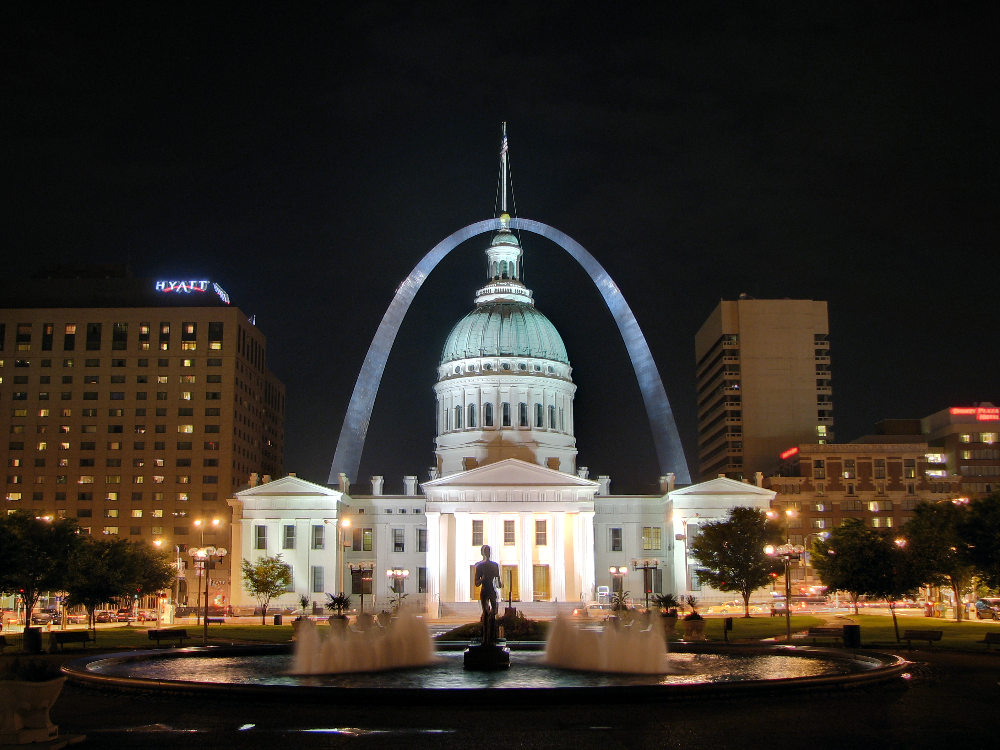

In [2]:
display(Image.open('data/gt_hdr.png'))

# Naive Edit

In [ ]:
merge(['data/naive_bright.png', 'data/gt_medium.png', 'data/naive_dark.png'], 'data/naive_hdr.png', False)

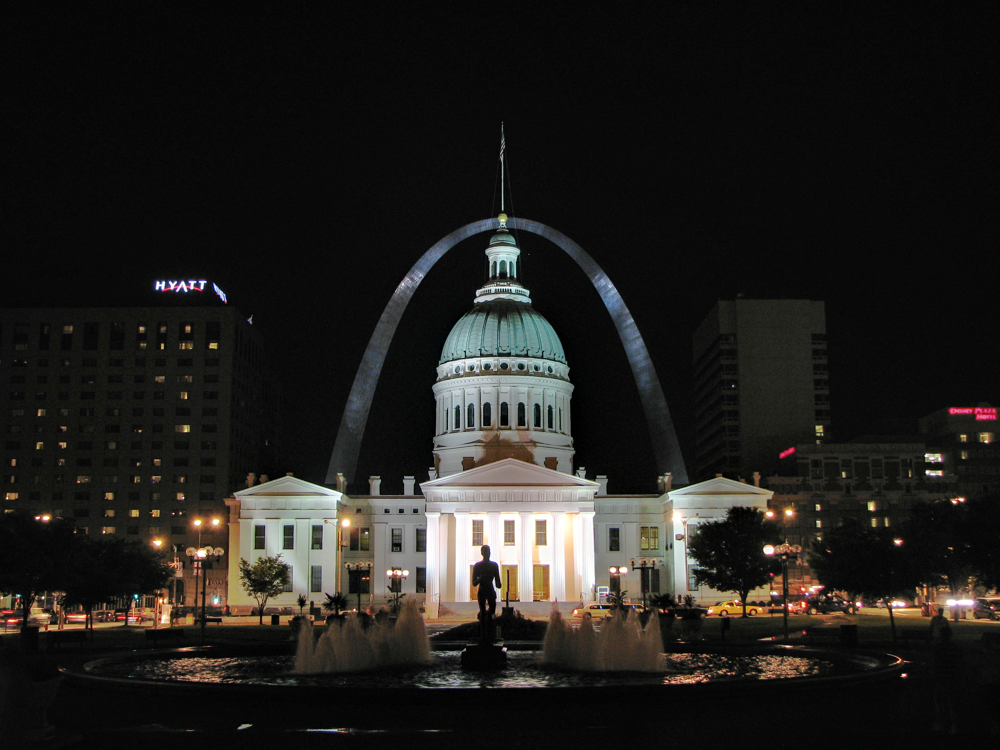

In [3]:
display(Image.open('data/naive_hdr.png'))

# Gaussian Blur

In [ ]:
merge(['data/gaussian_bright.png', 'data/gt_medium.png', 'data/gaussian_dark.png'], 'data/gaussian_hdr.png', False)

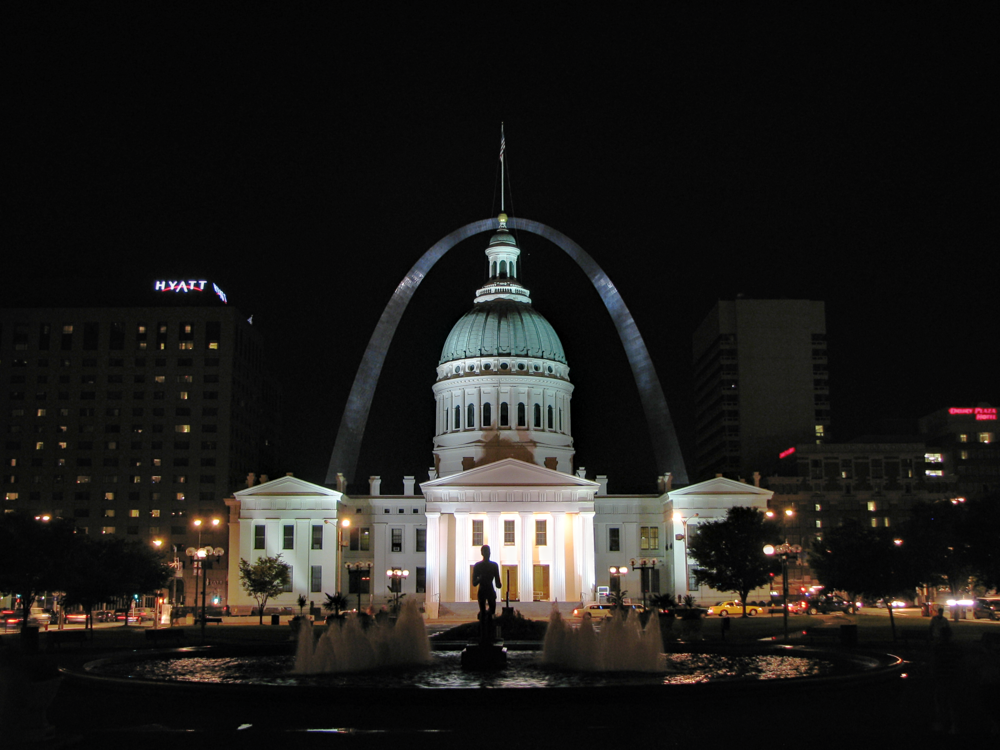

In [4]:
display(Image.open('data/gaussian_hdr.png'))

# BM3D

In [ ]:
merge(['data/bm3d_bright.png', 'data/gt_medium.png', 'data/bm3d_dark.png'], 'data/bm3d_hdr.png', False)

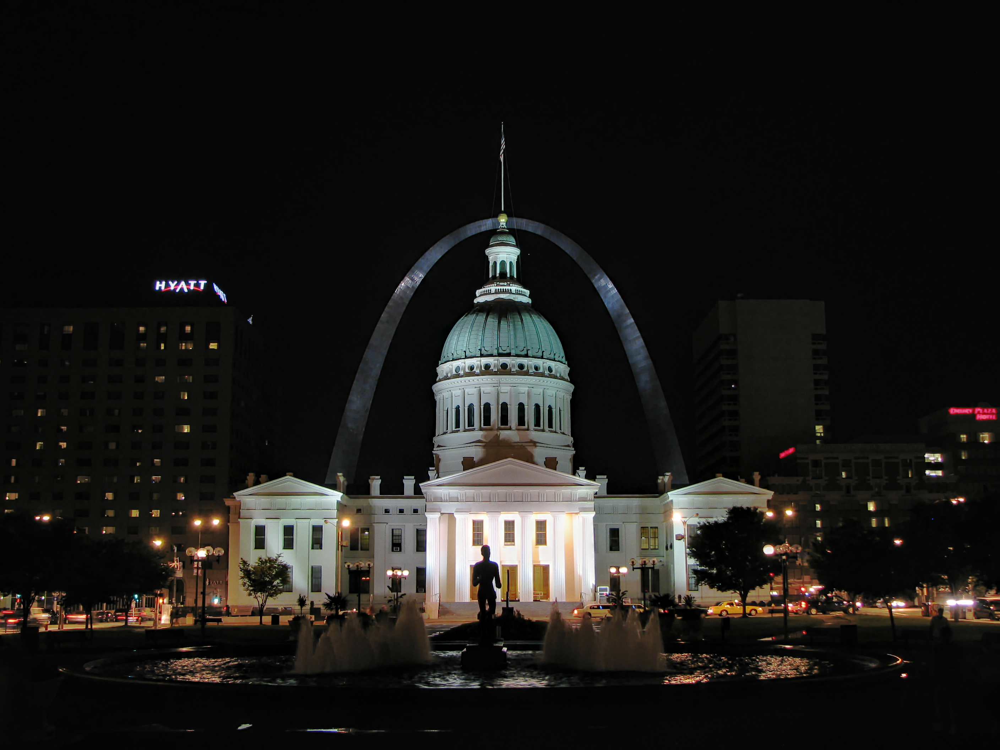

In [5]:
display(Image.open('data/bm3d_hdr.png'))

# Noise2Noise

In [ ]:
merge(['data/n2n_bright.png', 'data/gt_medium.png', 'data/n2n_dark.png'], 'data/n2n_hdr.png', False)

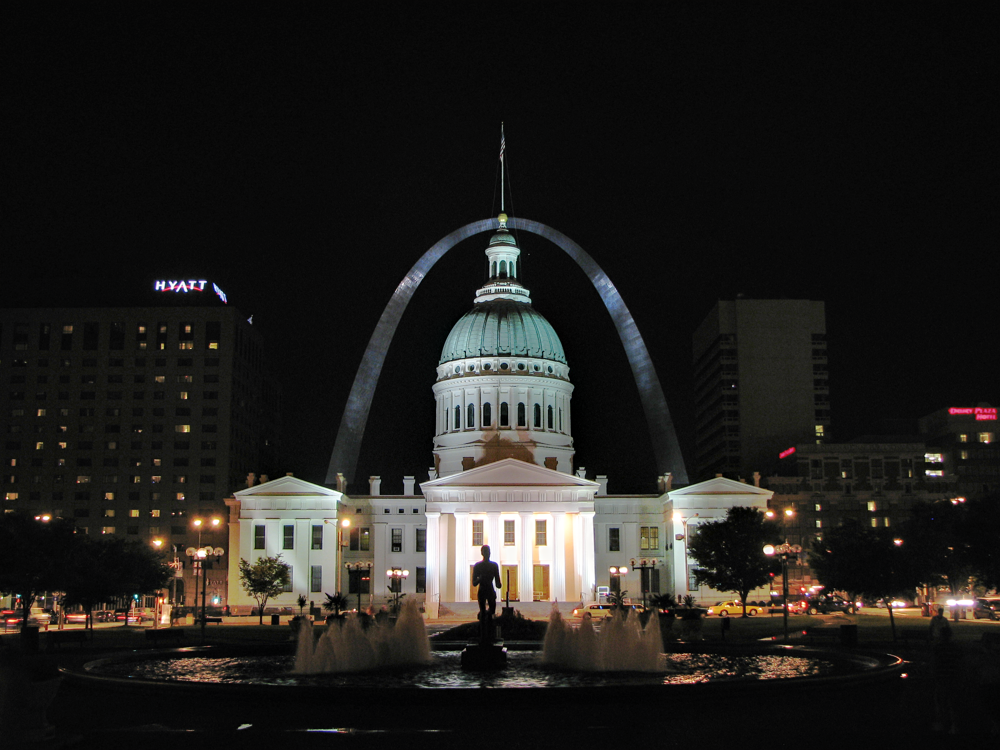

In [6]:
display(Image.open('data/n2n_hdr.png'))

# Deep Prior

In [ ]:
merge(['data/deepprior_bright6500.png', 'data/gt_medium_half.jpg', 'data/naive_dark_half.png'], 'data/deepprior_hdr.png', False)

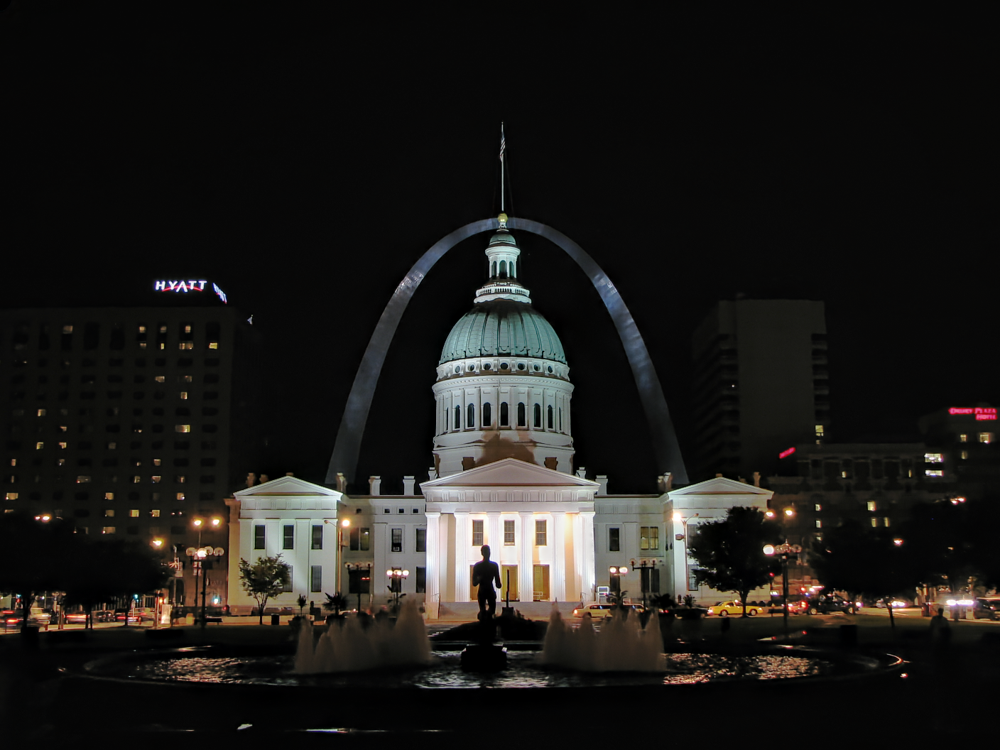

In [7]:
display(Image.open('data/deepprior_hdr.png'))